In [1]:
import os
import matplotlib.pyplot as plt
from matplotlib.tri import Triangulation
from matplotlib.patches import Patch
from matplotlib.patches import Rectangle
from matplotlib.lines import Line2D
from matplotlib.offsetbox import OffsetImage,AnnotationBbox,TextArea
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cv2
from scipy import stats
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn import preprocessing
while os.getcwd().split('\\')[-1] != 'ecological-networks':
    %cd ..
import setup_paths
setup_paths.add_path()
from Species_Reintroductions import *
DATA_TYPE = 'Real_1D'
CASE_TO_SOLVE_init(DATA_TYPE)
get_CASE()

d:\Github\ecological-networks\Code\01_Species_Reintroductions
d:\Github\ecological-networks\Code
d:\Github\ecological-networks
Real_1D


In [2]:
colors = [(0, 1, 0), 
            (1, 0, 1),
            (0, 0.5, 1),
            (1, 0.5, 0),
            (0.5, 0.75, 0.5),
            (0.47264038772966777, 0.1506862251841502, 0.5304625051012699),
            (0.0054805177084154, 0.5027721430949122, 0.12940295380858347),
            (1, 0, 0),
            (0.8823089789996199, 0.493678788666292, 0.8892782840854561),
            (0.03271773991374827, 0.000221350374740803, 0.9567679995198841),
            (0.0414758641641757, 0.9996957330917529, 0.996732605502944),
            (0.8591459280374928, 0.9899761277629354, 0.0650820102097951),
            (0, 1, 0.5),
            (0.5201352617671269, 0.3896798965802687, 0.002761428303301172),
            (0.949591741421414, 0.19157185077043304, 0.4750003740871874),
            (0.5553102772096091, 0.8284890667516454, 0.9772465299630206),
            (0, 0, 0.5),
            (0.9988019434779337, 0.7374329328164495, 0.45962478847804855),
            (0.046559985354347355, 0.5521911740910099, 0.56055644903229),
            (0.5081631589446748, 0.006532051047251297, 0.04344681604116041),
            (0.4579156265165718, 0.31672609574713817, 0.9918008380725485),
            (0.42853814104846577, 0.822795193722539, 0.013654786575626243),
            (0.6867941790535642, 0.43567343397599934, 0.46860944519820713),
            (0.2241578576124671, 0.2290893914733737, 0.20176106329817278),
            (0.7452502529335159, 0.9904463863990287, 0.6365904688996893),
            (0.6041319153204198, 0.0057674313956948, 0.9486509491472104),
            (0.13545745804914155, 0.7904932666454806, 0.2698792525894961),
            (0.3468511537854648, 0.6036574101284757, 0.8103800124066326),
            (0.7624328886997793, 0.6819372439925095, 0.1784396447896458),
            (0.031659945769193065, 0.2489667034682198, 0.7044793296713322)
            ]
colors_2 = [(0, 1, 1),
            (0.5, 0.5, 0.5),
            (1, 1, 0),
            (1, 0, 1),
            (0, 0.5, 0),
            (0, 0.5, 1),
            (0.5, 0, 0.5),
            (0.5, 1, 0.5),
            (1, 0.5, 0),
            (1, 0.5, 1),
            (0.5699847167696419, 0.29211784895932047, 0.9661717673827248),
            (0.5058800150384963, 0.7352216140189182, 0.9572076775042913),
            (0.4884773364115258, 0.3094021898789173, 0.04499770062209285),
            (0.006851873455735236, 0.26863329730148533, 0.4331985467932692),
            (0.0608636545527661, 0.740445723645124, 0.3861094152633544),
            (0.9379887496651372, 0.24555551115745955, 0.4742349588395205),
            (0.9109192928352678, 0.7469520267801562, 0.4511263451155285),
            (0.5438353831455061, 0.7637646368632363, 0.04815157127522707),
            (0.2234831212355105, 0.17884006083760995, 0.7516514476975154),
            (0.05331579137197273, 0.7397859321164656, 0.7630152338140559),
            (0.5, 0, 0),
            (0.5, 0, 1),
            (0.13237679452537643, 0.9825618368618366, 0.5813040364106073),
            (0.8613124487498045, 0.24610055161941047, 0.07974589558521361),
            (0.17075535566681155, 0.4737803022899517, 0.6955294328645806),
            (0.666554153269226, 0.9856806742403351, 0.8574190817350849),
            (0.015896378183202442, 0.0022583140955076964, 0.5618350997045818),
            (0.8406674457375312, 0.5094815305007924, 0.6525075209839627),
            (0.7584551722356677, 0.09940246145813403, 0.7567406239379257),
            (0.7899978749715801, 0.021394302707134938, 0.3100090038734268)
            ]

In [ ]:
Data = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '03_Scatter_Data', 'ScatterData', '04', 'M_PL_041.pkl'))

In [ ]:
type(Data)

In [ ]:
Data.shape

In [3]:
def main():
    for CASE_TO_SOLVE, loc in itertools.islice(zip(['Real_1D', 'Syn_01', 'Syn_2D', 'Real_2D'],['01','02','03','04']), 0, 1, 1):
        DATA_TYPE = CASE_TO_SOLVE
        CASE_TO_SOLVE_init(DATA_TYPE)
        NetworkName_Solved_df = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '01_Simulation_Execution', f"Network_Solved_{DATA_TYPE.split('_')[0]}.pkl"))
        for NetworkName in NetworkName_Solved_df.NetworkName.to_numpy():
            X = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '03_Scatter_Data', 'ScatterData', f"{loc}", f"{NetworkName}.pkl"))
            DF = pd.DataFrame([],columns = ['n','m','L','S','A','C','N','Abundance','Ob Abundance','Settling Time','Persistence'])
            X = X.apply(pd.to_numeric)
            X.drop(X[ X['Ob Abundance'] == 0 ].index ,inplace = True)
            DF = pd.concat([DF,X], ignore_index = True)
            DF = DF.apply(pd.to_numeric)
            DF.sort_values(by = ['Abundance', 'Ob Abundance'], axis = 0, inplace = True, ignore_index = True)
            DF.drop(DF[ DF['Ob Abundance'] == 0 ].index ,inplace = True)
            DF.reset_index(drop = True, inplace = True)
            print(NetworkName, ':', DF.shape)            

main()

M_PL_003 : (9664, 11)
M_PL_022 : (5102, 11)
M_PL_060_04 : (4348, 11)
M_PL_060_07 : (8551, 11)
M_PL_060_06 : (8006, 11)
M_PL_040 : (8825, 11)
M_PL_041 : (9509, 11)
M_PL_030 : (7954, 11)
M_PL_012 : (7680, 11)
M_PL_060_05 : (10064, 11)
M_PL_072_04 : (7279, 11)
M_PL_023 : (5851, 11)
M_PL_072_02 : (10158, 11)
M_PL_031 : (17352, 11)
M_PL_035 : (21823, 11)
M_PL_017 : (5376, 11)
M_PL_072_01 : (12992, 11)
M_PL_010 : (7363, 11)
M_PL_002 : (14488, 11)
M_PL_043 : (7230, 11)
M_PL_014 : (9053, 11)
M_PL_058 : (9948, 11)
M_PL_072_03 : (12636, 11)
M_PL_019 : (13234, 11)
M_PL_009 : (5730, 11)
M_PL_018 : (10859, 11)
M_PL_034 : (5993, 11)
M_PL_026 : (39135, 11)
M_PL_029 : (15962, 11)
M_PL_028 : (13003, 11)


In [29]:
def get_ScatterPlot(SHOW_PLOT = True, set_dpi = 100, plot_which = 'Real', c_custom = None):
    if plot_which == 'Real':
        loc_lst = ['01','04']
        Name_Network = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '01_Simulation_Execution', f"Network_Solved_Real.pkl")).NetworkName.to_numpy()
    elif plot_which == 'Syn':
        loc_lst = ['02','03']
        Name_Network = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '01_Simulation_Execution', f"Network_Solved_Syn.pkl")).NetworkName.to_numpy()

    FileName = os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '03_Scatter_Data', f"Scatter_01_Consolidated.pkl")
    D01 = UnpickleObj(FileName)[4]
    D01.drop(D01[ D01['N'] == 0 ].index ,inplace = True)
    D01.dropna(axis = 0, inplace = True)
    D01 = D01[D01['Abundance'] > 1.0]
    D01.reset_index(drop = True, inplace = True)

    FileName = os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '03_Scatter_Data', f"Scatter_02_Consolidated.pkl")
    D02 = UnpickleObj(FileName)[4]
    D02.drop(D02[ D02['N'] == 0 ].index ,inplace = True)
    D02.dropna(axis = 0, inplace = True)
    D02 = D02[D02['Abundance'] > 1.0]
    D02.reset_index(drop = True, inplace = True)

    FileName = os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '03_Scatter_Data', f"Scatter_03_Consolidated.pkl")
    D03 = UnpickleObj(FileName)[4]
    D03.drop(D03[ D03['N'] == 0 ].index ,inplace = True)
    D03.dropna(axis = 0, inplace = True)
    D03 = D03[D03['Abundance'] > 0.3]
    D03.reset_index(drop = True, inplace = True)

    FileName = os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '03_Scatter_Data', f"Scatter_04_Consolidated.pkl")
    D04 = UnpickleObj(FileName)[4]
    D04.drop(D04[ D04['N'] == 0 ].index ,inplace = True)
    D04.dropna(axis = 0, inplace = True)
    D04 = D04[D04['Abundance'] > 0.3]
    D04.reset_index(drop = True, inplace = True)
    
    D_1D = pd.concat([D01,D02], ignore_index = True)
    D_2D = pd.concat([D04,D03], ignore_index = True)
    #del D01,D02,D03,D04
    
    D_lst = list([D_1D, D_2D])
    D_lst_Full = list([[D01,D02], [D04,D03]])
    V_lst = ['S','A','C','N']

    D1 = D_1D.copy()
    D2 = D_2D.copy()
    
    for Col_Name in list(D_1D.columns):
        X_scaled = preprocessing.MinMaxScaler().fit_transform(np.array(D1[Col_Name]).reshape(-1,1))
        D1[Col_Name] = X_scaled
        X_scaled = preprocessing.MinMaxScaler().fit_transform(np.array(D2[Col_Name]).reshape(-1,1))
        D2[Col_Name] = X_scaled
    del Col_Name, X_scaled
    
    D_corr = [D1.corr(), D2.corr()]

    P_val = {}
    P_val['1D'] = {}
    P_val['2D'] = {}
    for i in list(D_1D.columns)[3:7]:
        for j in list(D_1D.columns)[-3:]:
            stat, p = stats.ttest_rel(D1[i],D1[j])
            P_val['1D'][i,j] = p
            # print(f"1D : [{i}, {j}] ;- {p}")
            stat, p = stats.ttest_ind(D2[i],D2[j], equal_var=False)
            P_val['2D'][i,j] = p
            # print(f"2D : [{i}, {j}] ;- {p}")
    '''
    DF -> loc, NetworkName
    ['Real_1D', 'Syn_01', 'Syn_2D', 'Real_2D'],['01','02','03','04']
    D_ind -> loc
        0 -> 01, 02
        1 -> 03, 04
    '''
    Book = {}
    if SHOW_PLOT:
        for Vy in ['Ob Abundance', 'Settling Time', 'Persistence']:
            f, ax = plt.subplots(2,4, figsize = (30,15), dpi = set_dpi, sharey = 'row')
            f.tight_layout(pad = 0)
            for D_ind in range(len(D_lst)): # 0: 1D, 1: 2D
                D = D_lst[D_ind]
                D_Full = D_lst_Full[D_ind]
                D_copy = D.copy()
                for Col_Name in list(D.columns):
                    X_scaled = preprocessing.MinMaxScaler().fit_transform(np.array(D_copy[Col_Name]).reshape(-1,1))
                    D_copy[Col_Name] = X_scaled
                del X_scaled
                
                regr_all = LinearRegression().fit(D_copy[['S', 'A', 'C', 'N']],D_copy[Vy])
                r2_all = r2_score(D_copy[Vy], regr_all.predict(D_copy[['S', 'A', 'C', 'N']]))
                
                for Network_Ind, NetworkName in enumerate(Name_Network):
                    X = UnpickleObj(os.path.join(os.getcwd(), 'Code', '01_Species_Reintroductions', '03_Scatter_Data', 'ScatterData', f"{loc_lst[D_ind]}", f"{NetworkName}.pkl"))
                    DF = pd.DataFrame([],columns = ['n','m','L','S','A','C','N','Abundance','Ob Abundance','Settling Time','Persistence'])
                    X = X.apply(pd.to_numeric)
                    X.drop(X[ X['Ob Abundance'] == 0 ].index ,inplace = True)
                    DF = pd.concat([DF,X], ignore_index = True)
                    DF = DF.apply(pd.to_numeric)
                    DF.sort_values(by = ['Abundance', 'Ob Abundance'], axis = 0, inplace = True, ignore_index = True)
                    DF.drop(DF[ DF['Ob Abundance'] == 0 ].index ,inplace = True)
                    DF.reset_index(drop = True, inplace = True)
                    
                    DF.drop(DF[ DF['N'] == 0 ].index ,inplace = True)
                    DF.dropna(axis = 0, inplace = True)
                    if D_ind == 0:
                        DF = DF[DF['Abundance'] > 1.0]
                    elif D_ind == 1:
                        DF = DF[DF['Abundance'] > 0.3]
                    DF.reset_index(drop = True, inplace = True)
                    del X
                    for V_ind in [0,1,2,3]:
                        V = V_lst[V_ind]
                        X_seq = np.array(D[V]).reshape(-1,1)
                        Y_seq = np.array(D[Vy]).reshape(-1,1)
                        
                        X_Real = np.array(D_Full[0][V]).reshape(-1,1)
                        Y_Real = np.array(D_Full[0][Vy]).reshape(-1,1)
                        X_Syn = np.array(D_Full[1][V]).reshape(-1,1)
                        Y_Syn = np.array(D_Full[1][Vy]).reshape(-1,1)

                        X_Network = np.array(DF[V]).reshape(-1,1)
                        Y_Network = np.array(DF[Vy]).reshape(-1,1)

                        if (Vy == 'Ob Abundance') and (D_ind == 0):
                            Y_seq = (Y_seq - 0) / (14-0)
                            Y_Real = (Y_Real - 0) / (14-0)
                            Y_Syn = (Y_Syn - 0) / (14-0)
                            Y_Network = (Y_Network - 0) / (14-0)
                        
                        if Vy in ['Abundance','Ob Abundance']:
                            #ax[D_ind,V_ind].scatter(X_seq,Y_seq, alpha = 0.05, color = 'black', marker = 1)
                            #ax[D_ind,V_ind].scatter(X_Real,Y_Real, alpha = 0.05, color = 'lightskyblue', marker = 1)
                            #ax[D_ind,V_ind].scatter(X_Syn,Y_Syn, alpha = 0.05, color = 'mediumspringgreen', marker = 1)
                            ax[D_ind,V_ind].scatter(X_Network,Y_Network, alpha = 0.05, color = c_custom[Network_Ind], marker = 1)
                        if Vy in ['Settling Time']:
                            #ax[D_ind,V_ind].scatter(X_seq,Y_seq, alpha = 0.10, color = 'black', marker = 2)
                            #ax[D_ind,V_ind].scatter(X_Real,Y_Real, alpha = 0.10, color = 'lightskyblue', marker = 2)
                            #ax[D_ind,V_ind].scatter(X_Syn,Y_Syn, alpha = 0.10, color = 'mediumspringgreen', marker = 2)
                            ax[D_ind,V_ind].scatter(X_Network,Y_Network, alpha = 0.10, color = c_custom[Network_Ind], marker = 2)
                        if Vy in ['Persistence']:
                            #ax[D_ind,V_ind].scatter(X_seq,Y_seq, alpha = 0.10, color = 'black', marker = 2)
                            #ax[D_ind,V_ind].scatter(X_Real,Y_Real, alpha = 0.10, color = 'lightskyblue', marker = 2)
                            #ax[D_ind,V_ind].scatter(X_Syn,Y_Syn, alpha = 0.10, color = 'mediumspringgreen', marker = 2)
                            ax[D_ind,V_ind].scatter(X_Network,Y_Network, alpha = 0.10, color = c_custom[Network_Ind], marker = 2)

                        if plot_which == 'Real':
                            regr_R = LinearRegression().fit(X_Real,Y_Real)
                            ax[D_ind,V_ind].plot(X_seq,regr_R.predict(X_seq), color="red", linewidth = 5)
                        if plot_which == 'Syn':
                            regr_S = LinearRegression().fit(X_Syn,Y_Syn)
                            ax[D_ind,V_ind].plot(X_seq,regr_S.predict(X_seq), color="red", linewidth = 5)

                        regr = LinearRegression().fit(X_seq,Y_seq)
                        #ax[D_ind,V_ind].plot(X_seq,regr.predict(X_seq),color="red", linewidth = 5)
                        
                        r2 = r2_score(Y_seq, regr.predict(X_seq))
                        Book[(D_ind, Vy, V)] = r2
                        
                        ax[D_ind,V_ind].tick_params(labelsize = 40, rotation = 30)
                        ax[D_ind,V_ind].tick_params(axis='y', which='major', pad=5)
                        # plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.3)
                        plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.15, hspace=0.15)
                        
                        if D_ind == 0:
                            if Vy == 'Abundance':ax[D_ind,V_ind].set_ylim([0,1.0])
                            if Vy == 'Ob Abundance':
                                ax[D_ind,V_ind].set_ylim([0,1.05])
                                #ax[D_ind,V_ind].set_yticks(np.arange(0.0,1.05,0.25))
                            if Vy == 'Settling Time':
                                ax[D_ind,V_ind].set_ylim([0,300])
                            if Vy == 'Persistence':
                                ax[D_ind,V_ind].set_ylim([0,1.0])
                            if V == "S":
                                if Vy in ['Abundance','Ob Abundance']:
                                    #ax[D_ind,V_ind].set_ylabel('1-D Model \n'+r"<$X$> $\longrightarrow$", fontsize = 45)
                                    # ax[D_ind,V_ind].set_yticks(np.arange(14))
                                    # ax[D_ind,V_ind].set_yticklabels(['0','','','','4','','','','8','','','','12',''])
                                    f.text(-0.15, 0.5, r"Abundance $\longrightarrow$", va='center', ha='center',rotation = 'vertical', fontsize=66, style='italic')
                                if Vy in ['Settling Time']:
                                    #ax[D_ind,V_ind].set_ylabel('1-D Model \n'+r"<$ST$> $\longrightarrow$", fontsize = 45)
                                    f.text(-0.15, 0.5, r"Settling TIme $\longrightarrow$", va='center', ha='center',rotation = 'vertical', fontsize=66, style='italic')
                                if Vy in ['Persistence']:
                                    #ax[D_ind,V_ind].set_ylim([0,1.00])
                                    #ax[D_ind,V_ind].set_ylabel('1-D Model \n'+r"<$P$> $\longrightarrow$", fontsize = 45)
                                    f.text(-0.15, 0.5, r"Persistence $\longrightarrow$", va='center', ha='center',rotation = 'vertical', fontsize=66, style='italic')
                                #ax[D_ind,V_ind].set_ylabel(r"($R^2$ = " + str(round(r2_all,3)) + ')', fontsize = 40)
                                #ax[D_ind,V_ind].yaxis.label.set_color('red')
                            elif V == "A":
                                ax[D_ind,V_ind].set_xlim([0,20])
                                #ax[D_ind,V_ind].set_yticks([])
                            elif V == "C":
                                ax[D_ind,V_ind].set_xlim([0,0.5])
                                #ax[D_ind,V_ind].set_yticks([])
                            #elif V == "N":
                                #ax[D_ind,V_ind].set_yticks([])
                            
                            ax[D_ind,V_ind].set_xticklabels([])
                            f.text(-0.075, 0.75, r"1-D Model", va='center', ha='center',rotation = 'vertical', fontsize=66, style='italic')
                            
                        if D_ind == 1:
                            if Vy == 'Abundance':ax[D_ind,V_ind].set_ylim([0,1.0])
                            if Vy == 'Ob Abundance':
                                ax[D_ind,V_ind].set_ylim([0,1.05])
                            if Vy == 'Settling Time':
                                ax[D_ind,V_ind].set_ylim([75,175])
                            if Vy == 'Persistence':
                                ax[D_ind,V_ind].set_ylim([0,1.0])
                            if V == "S":
                                ax[D_ind,V_ind].set_xlabel('\n'+r"Network Size $\longrightarrow$", fontsize = 50)
                                #if Vy in ['Abundance','Ob Abundance']:
                                    #ax[D_ind,V_ind].set_ylabel('2-D Model \n'+r"<$X$> $\longrightarrow$", fontsize = 45)
                                #if Vy in ['Settling Time']:
                                    #ax[D_ind,V_ind].set_ylabel('2-D Model \n'+r"<$ST$> $\longrightarrow$", fontsize = 45)
                                #if Vy in ['Persistence']:
                                    #ax[D_ind,V_ind].set_ylim([0,1.05])
                                    #ax[D_ind,V_ind].set_ylabel('2-D Model \n'+r"<$P$> $\longrightarrow$", fontsize = 45)
                                #ax[D_ind,V_ind].set_ylabel(r"($R^2$ = " + str(round(r2_all,3)) + ')', fontsize = 40)
                                #ax[D_ind,V_ind].yaxis.label.set_color('red')
                                ax[D_ind,V_ind].set_xticks([0,50,100,150,200])
                                
                            elif V == "A":
                                ax[D_ind,V_ind].set_xlabel('\n'+r"Asymmetry $\longrightarrow$", fontsize = 50)
                                #ax[D_ind,V_ind].set_yticks([])
                                ax[D_ind,V_ind].set_xlim([0,20])
                            elif V == "C":
                                ax[D_ind,V_ind].set_xlabel('\n'+r"Connectance $\longrightarrow$", fontsize = 50)
                                #ax[D_ind,V_ind].set_yticks([])
                                ax[D_ind,V_ind].set_xlim([0,0.5])
                            elif V == "N":
                                ax[D_ind,V_ind].set_xlabel('\n'+r"Nestedness $\longrightarrow$", fontsize = 50)
                                #ax[D_ind,V_ind].set_yticks([])
                                ax[D_ind,V_ind].set_xlim([0,0.6])
                            f.text(-0.075, 0.25, r"2-D Model", va='center', ha='center',rotation = 'vertical', fontsize=66, style='italic')
                        '''
                        ax[D_ind,V_ind].text(0.55,0.05, r'$coef = $' + str(round(regr_all.coef_[V_ind],3)) + '\n' + r'$corr = $' + str(round(D_corr[D_ind].loc[V,Vy],3)), 
                                            transform=ax[D_ind,V_ind].transAxes, 
                                            fontsize = 30, 
                                            color = 'red',
                                            va='bottom', ha='left', 
                                            bbox = dict(boxstyle='round', facecolor='wheat', alpha=1.0)
                                            )
                        '''
        '''
        legend_elements = [
            Line2D([0], [0], marker='o', color='w', label='Real Networks', markerfacecolor='lightskyblue', markersize=50),
            Line2D([0], [0], marker='o', color='w', label='Synthetic Networks', markerfacecolor='mediumspringgreen', markersize=50),
            ]
        l1 = ax[-1,0].legend(handles=legend_elements, bbox_to_anchor = [1.0,-0.5], loc = 'upper left', title = '', fontsize = 44, frameon = False, ncol = 2)

        l1.get_texts()[0].set_color('blue')
        l1.get_texts()[1].set_color('green')
        '''
        # del D_lst, V_lst, Vy, f, ax, D_ind, V_ind, X_seq, Y_seq, regr, V, D
    return None
    #return D1, D2, P_val, Book

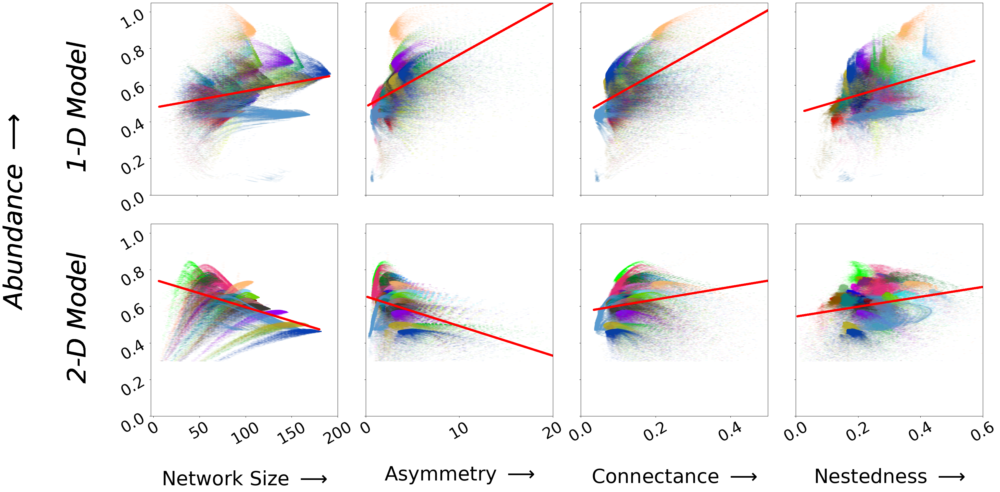

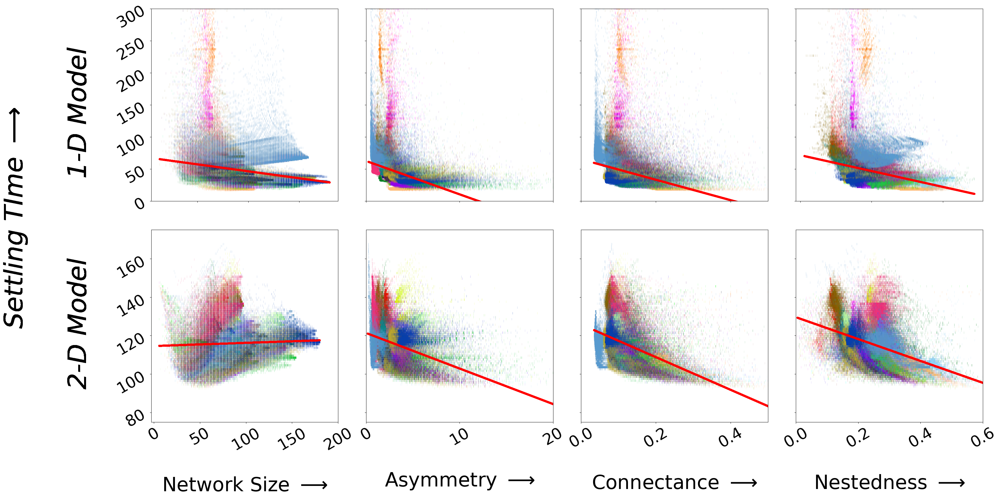

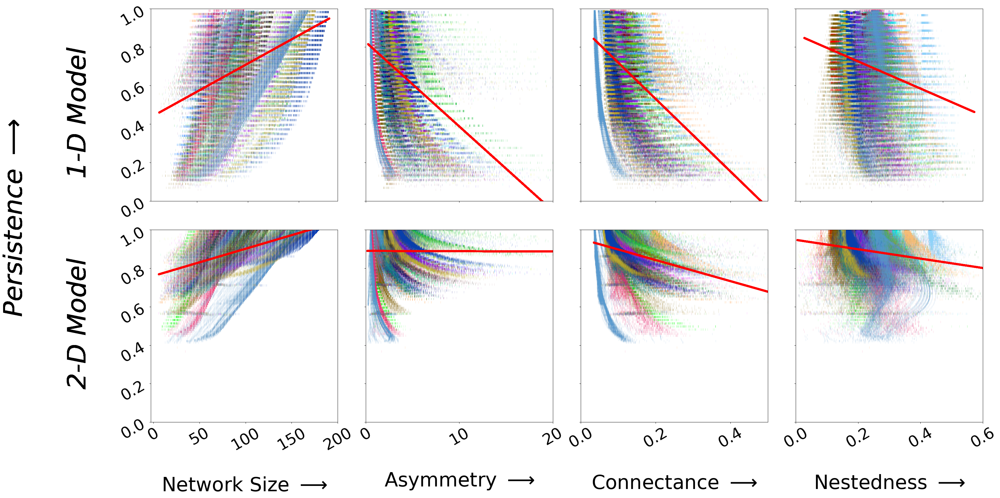

In [31]:
get_ScatterPlot(SHOW_PLOT = True, set_dpi = 100, plot_which = 'Real', c_custom = colors);

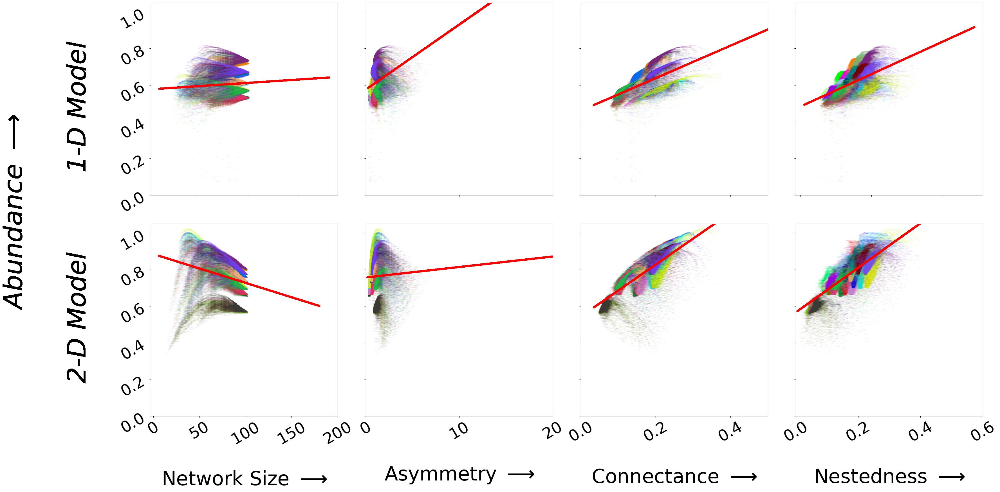

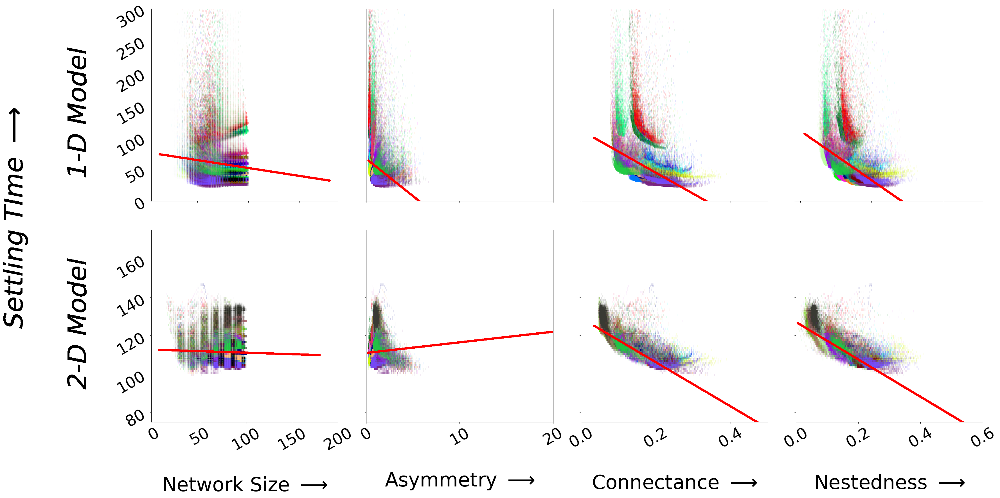

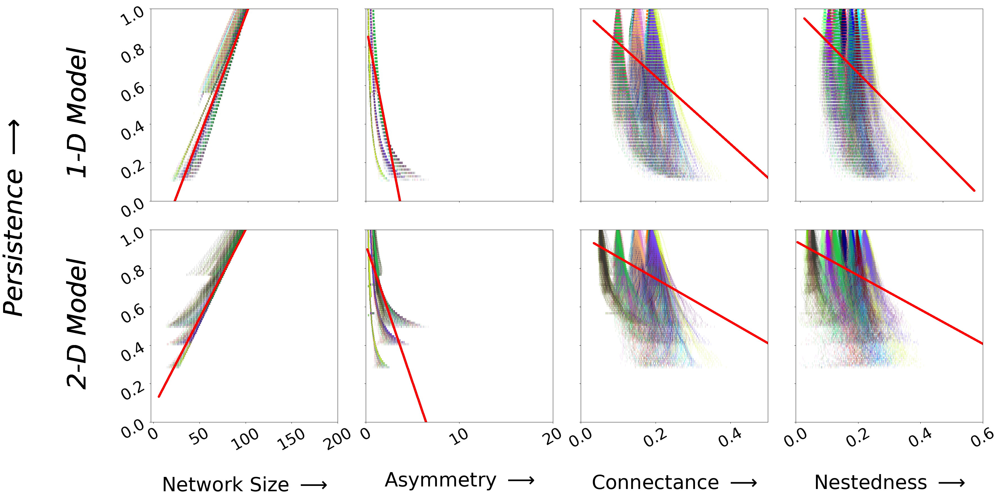

In [30]:
get_ScatterPlot(SHOW_PLOT = True, set_dpi = 100, plot_which = 'Syn', c_custom = colors);

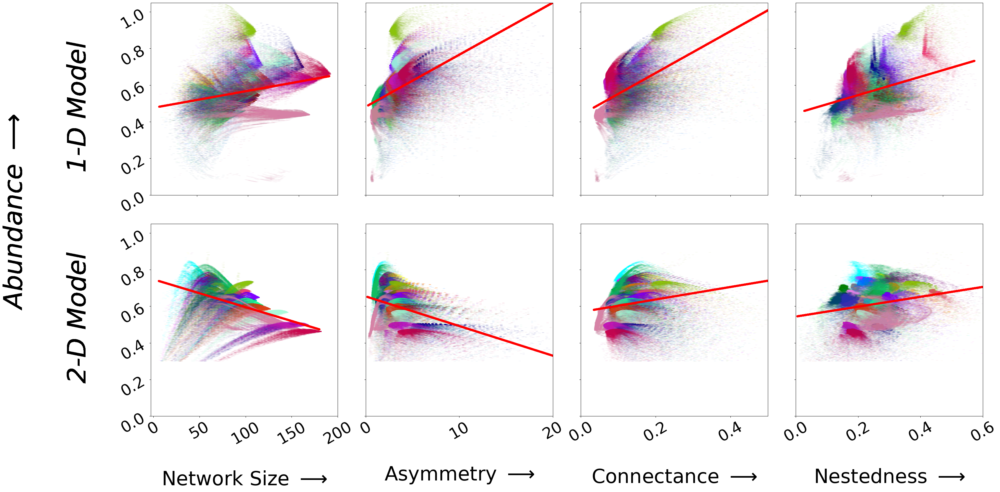

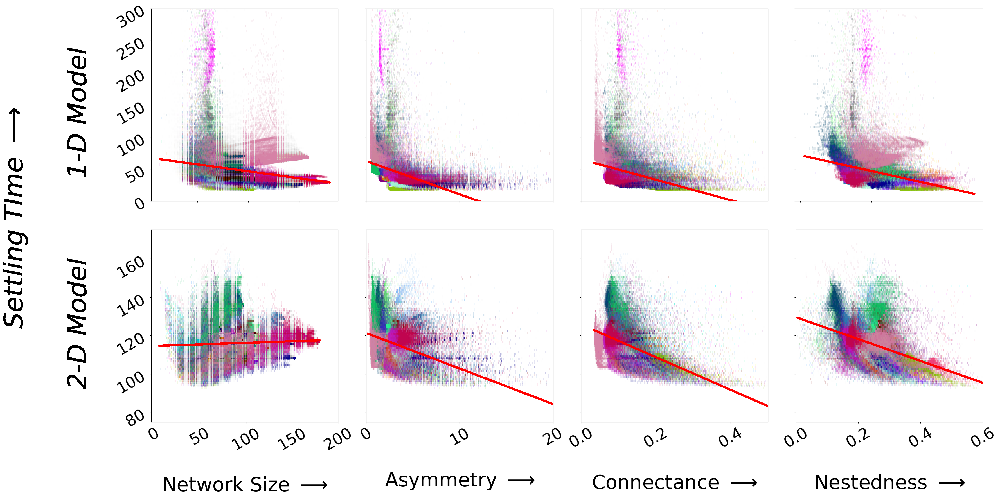

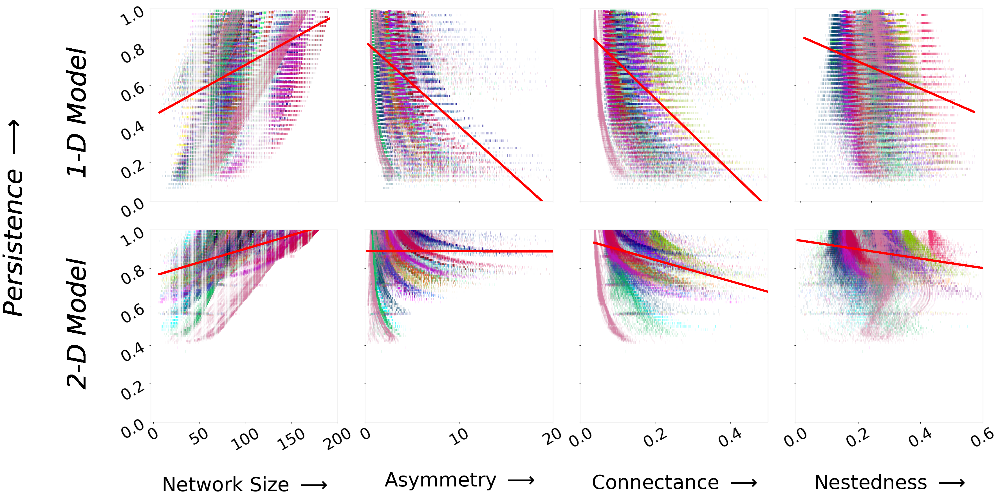

In [32]:
get_ScatterPlot(SHOW_PLOT = True, set_dpi = 100, plot_which = 'Real', c_custom = colors_2);

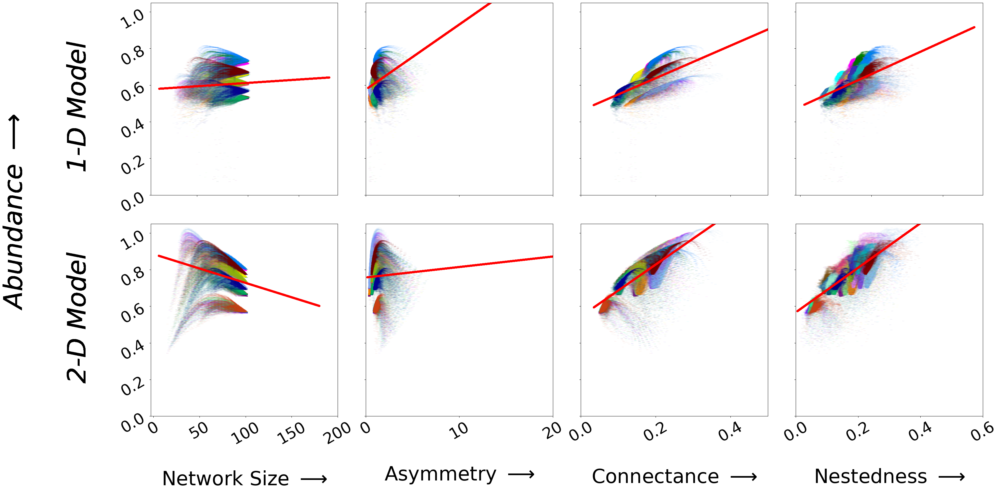

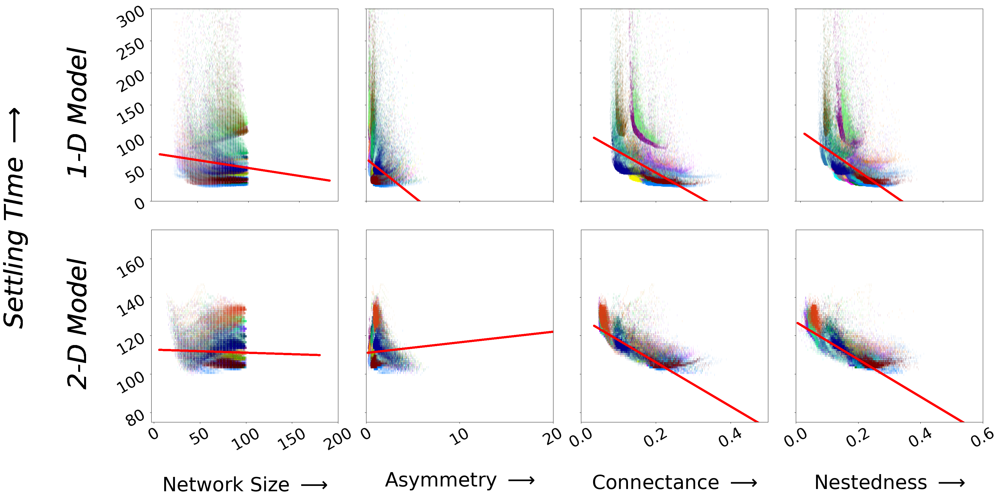

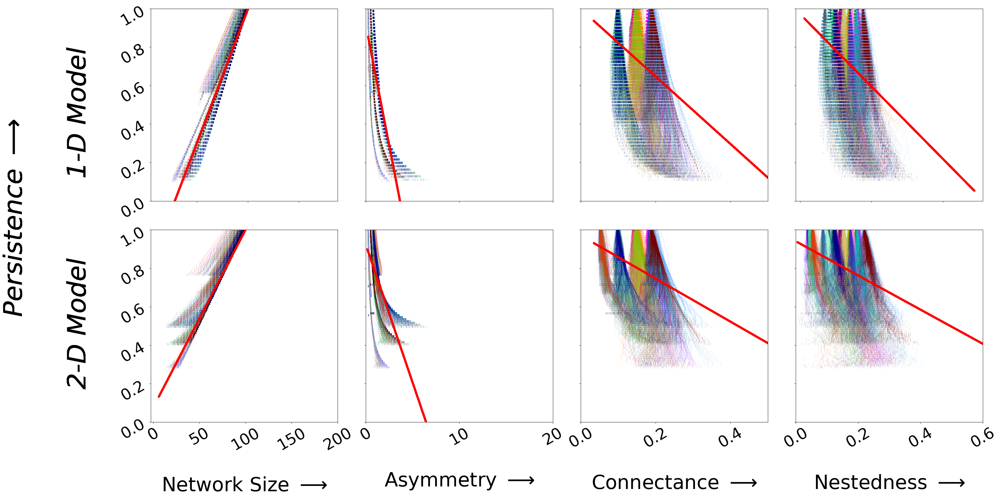

In [33]:
get_ScatterPlot(SHOW_PLOT = True, set_dpi = 100, plot_which = 'Syn', c_custom = colors_2);